<html><head><meta content="text/html; charset=UTF-8" http-equiv="content-type"><style type="text/css">ol</style></head><body class="c5"><p class="c0 c4"><span class="c3"></span></p><p class="c2 title" id="h.rrbabt268i6e"><h1>CaImAn&rsquo;s Demo pipeline</h1></p><p class="c0"><span class="c3">This notebook will help to demonstrate the process of CaImAn and how it uses different functions to denoise, deconvolve and demix neurons from a two-photon Calcium Imaging dataset. The demo shows how to construct the `params`, `MotionCorrect` and `cnmf` objects and call the relevant functions. You can also run a large part of the pipeline with a single method (`cnmf.fit_file`). See inside for details.

Dataset couresy of Sue Ann Koay and David Tank (Princeton University)

This demo pertains to two photon data. For a complete analysis pipeline for one photon microendoscopic data see demo_pipeline_cnmfE.ipynb</span></p>
<p class="c0"><span class="c3">More information can be found in the companion paper. </span></p>
</html>

In [1]:
import bokeh.plotting as bpl
import cv2
import glob
import logging
import matplotlib.pyplot as plt
import numpy as np
import os
from tqdm import tqdm

try:
    cv2.setNumThreads(0)
except():
    pass

try:
    if __IPYTHON__:
        # this is used for debugging purposes only. allows to reload classes
        # when changed
        get_ipython().magic('load_ext autoreload')
        get_ipython().magic('autoreload 2')
except NameError:
    pass

import caiman as cm
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import cnmf as cnmf
from caiman.source_extraction.cnmf import params as params
from caiman.utils.utils import download_demo
from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
from caiman.base.movies import load
bpl.output_notebook()

Loading BokehJS ...

### Set up logger (optional)
You can log to a file using the filename parameter, or make the output more or less verbose by setting level to `logging.DEBUG`, `logging.INFO`, `logging.WARNING`, or `logging.ERROR`. A filename argument can also be passed to store the log file

In [2]:
logging.basicConfig(format=
                          "%(relativeCreated)12d [%(filename)s:%(funcName)20s():%(lineno)s] [%(process)d] %(message)s",
                    # filename="/tmp/caiman.log",
                    level=logging.WARNING)

### Select file(s) to be processed
The `download_demo` function will download the specific file for you and return the complete path to the file which will be stored in your `caiman_data` directory. If you adapt this demo for your data make sure to pass the complete path to your file(s). Remember to pass the `fname` variable as a list.

In [3]:
fnames = ['/home/pbauer/DATA/LotusScan/20210819_EM0043_1.tiff']  # filename to be processed
#if fnames[0] in ['Sue_2x_3000_40_-46.tif', 'demoMovie.tif']:
#    fnames = [download_demo(fnames[0])]

In [4]:
sample = load(fnames[0], subindices=(range(1)))

       41965 [tifffile.py:         log_warning():16792] [3959969] TiffPages: corrupted tag list of page 4457 @ 11862095
       41967 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 82
       41968 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 407
       41969 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 83
       41969 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       41970 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 280
       41971 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1003
       41971 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 47
       41972 [tifffile.py:    

       42222 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1178
       42223 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 98
       42223 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       42224 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 950
       42224 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 54
       42225 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 574
       42225 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 126
       42225 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 402
       42227 [tifffile.py: 

       43018 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 27
       43019 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 40
       43019 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 20
       43020 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 70
       43020 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 167
       43021 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 67
       43021 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 443
       43022 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 747
       43022 [tifffile.py:   

       43389 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 61
       43389 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 64
       43390 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 24
       43390 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 356
       43391 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 64
       43391 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 70
       43392 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 92
       43393 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 215
       43393 [tifffile.py:    

       43548 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 74
       43548 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 362
       43549 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       43549 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 38
       43549 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 634
       43550 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 66
       43550 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 146
       43551 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 442
       43551 [tifffile.py:   

       44243 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 487
       44244 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 403
       44244 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       44244 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 218
       44247 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 130
       44247 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 102
       44248 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 130
       44248 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       44248 [tifffile.py:  

       44268 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 790
       44269 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 180
       44269 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       44269 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 555
       44270 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 328
       44270 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 14
       44270 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 159
       44270 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 121
       44271 [tifffile.py: 

       44293 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 102
       44293 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 74
       47005 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 226
       47007 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 162
       47007 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 238
       47008 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 154
       47009 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 682
       47009 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 38
       47010 [tifffile.py:

       47645 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 194
       47646 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 78
       47646 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 90
       47647 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 42
       47648 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 450
       47648 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 38
       47649 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       47649 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 46
       47650 [tifffile.py:     

       48933 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 42
       49025 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 426
       49026 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 81
       49027 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 50
       49027 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 32
       49028 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 285
       49029 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 225
       49030 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 41
       49030 [tifffile.py:   

       49228 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 42
       49228 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 62
       49353 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 70
       49354 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1337
       49355 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 513
       49355 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       49356 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 27
       49357 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 430
       49357 [tifffile.py:   

       49684 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1046
       49685 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 266
       49685 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 566
       49686 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 54
       49686 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 202
       49687 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 206
       49687 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 110
       49688 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       49688 [tifffile.py:

       52478 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 347
       52479 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 90
       52479 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 130
       52480 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       52481 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 670
       52481 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 77
       52482 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 40
       52483 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 246
       52483 [tifffile.py:   

       52748 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 76
       52749 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 61
       52749 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 33
       52750 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 79
       52751 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 360
       52751 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 50
       52752 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 95
       52752 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 245
       52753 [tifffile.py:    

       53752 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       53753 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 754
       53753 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 398
       53753 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       53754 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 126
       53755 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 58
       53755 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 78
       53756 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 254
       53756 [tifffile.py:    

       54886 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 26
       54886 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 14
       54887 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 62
       54888 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 402
       54888 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 446
       54889 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 258
       54889 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       54890 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       54891 [tifffile.py:     

       54999 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 116
       54999 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 98
       54999 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 50
       55000 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 319
       55000 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 163
       55000 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1162
       55000 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 98
       55001 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 70
       55001 [tifffile.py: 

       59375 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 338
       59375 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 66
       59375 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 74
       59376 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 94
       59376 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 454
       59376 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 334
       59377 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 58
       59377 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 417
       59377 [tifffile.py:  

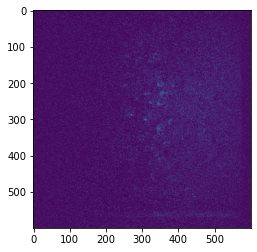

In [5]:
plt.imshow(sample)

In [6]:
sample.shape

(600, 600)

In [7]:
# OPTIONAL: CROP AND DOWNSAMPLE RAW VIDEO (TAKES SOME TIME)
cropping = (0, 0, 600, 600)
sds_ratio = .5  # spatial downsampling  
tds_ratio = .5  # temporal downsampling

for i, moviepath in tqdm(enumerate(fnames)):
    movie = cm.load(moviepath)

    # CROP
    movie_cropped = movie[:, cropping[1]:cropping[1]+cropping[3],cropping[0]:cropping[0]+cropping[2]]

    # RESIZE
    movie_resized = movie_cropped.resize(sds_ratio, sds_ratio, tds_ratio)  # resizing
    movie_resized.save(fnames[i])
    
    # CONCATENATE if several files exist
    if i==0:
        movies_concat = movie_resized.copy()
    else:
        movies_concat = cm.concatenate([movies_concat, movie_resized], axis=0)
    del movie, movie_cropped, movie_resized  # delete objects to save memory    


0it [00:00, ?it/s]       85754 [tifffile.py:         log_warning():16792] [3959969] TiffPages: corrupted tag list of page 4457 @ 11862095
       85755 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 82
       85756 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 407
       85757 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 83
       85757 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       85758 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 280
       85759 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1003
       85759 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 47
       85760

       86014 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1178
       86015 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 98
       86015 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       86016 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 950
       86017 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 54
       86017 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 574
       86017 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 126
       86018 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 402
       86018 [tifffile.py: 

       86824 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 27
       86825 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 40
       86825 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 20
       86826 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 70
       86827 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 167
       86827 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 67
       86828 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 443
       86828 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 747
       86829 [tifffile.py:   

       87194 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 61
       87195 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 64
       87195 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 24
       87196 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 356
       87196 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 64
       87197 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 70
       87198 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 92
       87198 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 215
       87199 [tifffile.py:    

       87358 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 74
       87358 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 362
       87359 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       87359 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 38
       88296 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 634
       88296 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 66
       88297 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 146
       88297 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 442
       88297 [tifffile.py:   

       88315 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 487
       88315 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 403
       88316 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       88316 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 218
       88316 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 130
       88317 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 102
       88317 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 130
       88317 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       88318 [tifffile.py:  

       88335 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 790
       88335 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 180
       88336 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       88336 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 555
       88336 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 328
       88337 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 14
       88337 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 159
       88337 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 121
       88338 [tifffile.py: 

       88371 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 102
       88371 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 74
       91189 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 226
       91192 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 162
       91193 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 238
       91193 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 154
       91194 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 682
       91195 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 38
       91195 [tifffile.py:

       91861 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 194
       91862 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 78
       91862 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 90
       91862 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 42
       91863 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 450
       91863 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 38
       91863 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       91863 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 46
       91864 [tifffile.py:     

       93138 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 42
       93230 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 426
       93231 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 81
       93231 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 50
       93232 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 32
       93233 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 285
       93234 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 225
       93235 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 41
       93235 [tifffile.py:   

       93437 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 42
       93438 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 62
       93559 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 70
       93561 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1337
       93562 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 513
       93562 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       93563 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 27
       93564 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 430
       93564 [tifffile.py:   

       93882 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1046
       93882 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 266
       93883 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 566
       93883 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 54
       93884 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 202
       93884 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 206
       93885 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 110
       93885 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       93886 [tifffile.py:

       96741 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 347
       96742 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 90
       96744 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 130
       96744 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       96745 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 670
       96745 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 77
       96746 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 40
       96746 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 246
       96747 [tifffile.py:   

       97011 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 76
       97012 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 61
       97012 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 33
       97013 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 79
       97013 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 360
       97014 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 50
       97014 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 95
       97015 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 245
       97015 [tifffile.py:    

       98006 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       98006 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 754
       98007 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 398
       98007 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       98007 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 126
       98008 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 58
       98008 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 78
       98009 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 254
       98009 [tifffile.py:    

       99124 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 26
       99125 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 14
       99125 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 62
       99126 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 402
       99126 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 446
       99127 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 258
       99128 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       99128 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 0
       99129 [tifffile.py:     

       99235 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 116
       99236 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 98
       99236 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 50
       99236 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 319
       99237 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 163
       99237 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 1162
       99237 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 98
       99237 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 70
       99238 [tifffile.py: 

      107211 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 338
      107212 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 66
      107212 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 74
      107213 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 94
      107213 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 454
      107214 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 334
      107214 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 58
      107215 [tifffile.py:         log_warning():16792] [3959969] TiffPage 4455: TiffFileError: unknown tag data type 417
      107215 [tifffile.py:  

In [8]:
# save (concatenated) movie
if 'movies_concat' in locals() and i>0:
    fname = os.path.join(new_dir, os.path.basename(moviepath)[:-4]+'_concatenated.tif')
    if not os.path.exists(fname):
        movies_concat.save(fname)
else:
    fname = fnames[0]

### Play the movie (optional)
Play the movie (optional). This will require loading the movie in memory which in general is not needed by the pipeline. Displaying the movie uses the OpenCV library. Press `q` to close the video panel.

In [10]:
display_movie = True
if display_movie:
    m_orig = cm.load_movie_chain(fnames)
    ds_ratio = 0.2
    m_orig.resize(1, 1, ds_ratio).play(
        q_max=99.5, fr=30, magnification=2)

100%|███████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.16s/it]


### Setup some parameters
We set some parameters that are relevant to the file, and then parameters for motion correction, processing with CNMF and component quality evaluation. Note that the dataset `Sue_2x_3000_40_-46.tif` has been spatially downsampled by a factor of 2 and has a lower than usual spatial resolution (2um/pixel). As a result several parameters (`gSig, strides, max_shifts, rf, stride_cnmf`) have lower values (halved compared to a dataset with spatial resolution 1um/pixel).

In [12]:
# dataset dependent parameters
fr = 15                             # imaging rate in frames per second
decay_time = 0.4                    # length of a typical transient in seconds

# motion correction parameters
strides = (48, 48)          # start a new patch for pw-rigid motion correction every x pixels
overlaps = (24, 24)         # overlap between pathes (size of patch strides+overlaps)
max_shifts = (6,6)          # maximum allowed rigid shifts (in pixels)
max_deviation_rigid = 3     # maximum shifts deviation allowed for patch with respect to rigid shifts
pw_rigid = True             # flag for performing non-rigid motion correction

# parameters for source extraction and deconvolution
p = 1                       # order of the autoregressive system
gnb = 2                     # number of global background components
merge_thr = 0.85            # merging threshold, max correlation allowed
rf = 15                     # half-size of the patches in pixels. e.g., if rf=25, patches are 50x50
stride_cnmf = 6             # amount of overlap between the patches in pixels
K = 4                       # number of components per patch
gSig = [4, 4]               # expected half size of neurons in pixels
method_init = 'greedy_roi'  # initialization method (if analyzing dendritic data using 'sparse_nmf')
ssub = 1                    # spatial subsampling during initialization
tsub = 1                    # temporal subsampling during intialization

# parameters for component evaluation
min_SNR = 2.0               # signal to noise ratio for accepting a component
rval_thr = 0.85              # space correlation threshold for accepting a component
cnn_thr = 0.99              # threshold for CNN based classifier
cnn_lowest = 0.1 # neurons with cnn probability lower than this value are rejected

### Create a parameters object
You can creating a parameters object by passing all the parameters as a single dictionary. Parameters not defined in the dictionary will assume their default values. The resulting `params` object is a collection of subdictionaries pertaining to the dataset to be analyzed `(params.data)`, motion correction `(params.motion)`, data pre-processing `(params.preprocess)`, initialization `(params.init)`, patch processing `(params.patch)`, spatial and temporal component `(params.spatial), (params.temporal)`, quality evaluation `(params.quality)` and online processing `(params.online)`

In [13]:
opts_dict = {'fnames': fnames,
            'fr': fr,
            'decay_time': decay_time,
            'strides': strides,
            'overlaps': overlaps,
            'max_shifts': max_shifts,
            'max_deviation_rigid': max_deviation_rigid,
            'pw_rigid': pw_rigid,
            'p': p,
            'nb': gnb,
            'rf': rf,
            'K': K, 
            'stride': stride_cnmf,
            'method_init': method_init,
            'rolling_sum': True,
            'only_init': True,
            'ssub': ssub,
            'tsub': tsub,
            'merge_thr': merge_thr, 
            'min_SNR': min_SNR,
            'rval_thr': rval_thr,
            'use_cnn': True,
            'min_cnn_thr': cnn_thr,
            'cnn_lowest': cnn_lowest}

opts = params.CNMFParams(params_dict=opts_dict)

### Setup a cluster
To enable parallel processing a (local) cluster needs to be set up. This is done with a cell below. The variable `backend` determines the type of cluster used. The default value `'local'` uses the multiprocessing package. The `ipyparallel` option is also available. More information on these choices can be found [here](https://github.com/flatironinstitute/CaImAn/blob/master/CLUSTER.md). The resulting variable `dview` expresses the cluster option. If you use `dview=dview` in the downstream analysis then parallel processing will be used. If you use `dview=None` then no parallel processing will be employed.

In [14]:
#%% start a cluster for parallel processing (if a cluster already exists it will be closed and a new session will be opened)
if 'dview' in locals():
    cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)

## Motion Correction
First we create a motion correction object with the parameters specified. Note that the file is not loaded in memory

In [15]:
# first we create a motion correction object with the parameters specified
mc = MotionCorrect(fnames, dview=dview, **opts.get_group('motion'))
# note that the file is not loaded in memory

Now perform motion correction. From the movie above we see that the dateset exhibits non-uniform motion. We will perform piecewise rigid motion correction using the NoRMCorre algorithm. This has already been selected by setting `pw_rigid=True` when defining the parameters object.

In [16]:
%%time
%%capture
#%% Run piecewise-rigid motion correction using NoRMCorre
mc.motion_correct(save_movie=True)
m_els = cm.load(mc.fname_tot_els)
border_to_0 = 0 if mc.border_nan is 'copy' else mc.border_to_0 
    # maximum shift to be used for trimming against NaNs

CPU times: user 1.63 s, sys: 938 ms, total: 2.56 s
Wall time: 11.9 s


Inspect the results by comparing the original movie. A more detailed presentation of the motion correction method can be found in the [demo motion correction](./demo_motion_correction.ipynb) notebook.

In [17]:
#%% compare with original movie
display_movie = True
if display_movie:
    m_orig = cm.load_movie_chain(fnames)
    ds_ratio = 0.2
    cm.concatenate([m_orig.resize(1, 1, ds_ratio) - mc.min_mov*mc.nonneg_movie,
                    m_els.resize(1, 1, ds_ratio)], 
                   axis=2).play(fr=60, gain=15, magnification=2, offset=0)  # press q to exit

100%|███████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.05s/it]


## Memory mapping 

The cell below memory maps the file in order `'C'` and then loads the new memory mapped file. The saved files from motion correction are memory mapped files stored in `'F'` order. Their paths are stored in `mc.mmap_file`.

In [19]:
#%% MEMORY MAPPING
# memory map the file in order 'C'
fname_new = cm.save_memmap(mc.mmap_file, base_name='memmap_', order='C',
                           border_to_0=border_to_0, dview=dview) # exclude borders

# now load the file
Yr, dims, T = cm.load_memmap(fname_new)
images = np.reshape(Yr.T, [T] + list(dims), order='F') 
    #load frames in python format (T x X x Y)

Now restart the cluster to clean up memory

In [20]:
#%% restart cluster to clean up memory
cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"
/home/pbauer/anaconda3/envs/CaIman/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1090: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve con

## Run CNMF on patches in parallel

- The FOV is split is different overlapping patches that are subsequently processed in parallel by the CNMF algorithm.
- The results from all the patches are merged with special attention to idendtified components on the border.
- The results are then refined by additional CNMF iterations.

In [22]:
%%time
%%capture
#%% RUN CNMF ON PATCHES
# First extract spatial and temporal components on patches and combine them
# for this step deconvolution is turned off (p=0). If you want to have
# deconvolution within each patch change params.patch['p_patch'] to a
# nonzero value
cnm = cnmf.CNMF(n_processes, params=opts, dview=dview)
cnm = cnm.fit(images)

CPU times: user 4.01 s, sys: 896 ms, total: 4.91 s
Wall time: 10.2 s


## Run the entire pipeline up to this point with one command
It is possible to run the combined steps of motion correction, memory mapping, and cnmf fitting in one step as shown below. The command is commented out since the analysis has already been performed. It is recommended that you familiriaze yourself with the various steps and the results of the various steps before using it.

In [ ]:
# cnm1 = cnmf.CNMF(n_processes, params=opts, dview=dview)
# cnm1.fit_file(motion_correct=True)

### Inspecting the results
Briefly inspect the results by plotting contours of identified components against correlation image.
The results of the algorithm are stored in the object `cnm.estimates`. More information can be found in the definition of the `estimates` object and in the [wiki](https://github.com/flatironinstitute/CaImAn/wiki/Interpreting-Results).

In [23]:
#%% plot contours of found components
Cn = cm.local_correlations(images.transpose(1,2,0))
Cn[np.isnan(Cn)] = 0
cnm.estimates.plot_contours_nb(img=Cn)

## Re-run (seeded) CNMF  on the full Field of View  
You can re-run the CNMF algorithm seeded on just the selected components from the previous step. Be careful, because components rejected on the previous step will not be recovered here.

In [24]:
%%time
%%capture
#%% RE-RUN seeded CNMF on accepted patches to refine and perform deconvolution 
cnm2 = cnm.refit(images, dview=dview)

CPU times: user 6.11 s, sys: 1.87 s, total: 7.99 s
Wall time: 10.7 s


## Component Evaluation

The processing in patches creates several spurious components. These are filtered out by evaluating each component using three different criteria:

- the shape of each component must be correlated with the data at the corresponding location within the FOV
- a minimum peak SNR is required over the length of a transient
- each shape passes a CNN based classifier

In [24]:
#%% COMPONENT EVALUATION
# the components are evaluated in three ways:
#   a) the shape of each component must be correlated with the data
#   b) a minimum peak SNR is required over the length of a transient
#   c) each shape passes a CNN based classifier

cnm2.estimates.evaluate_components(images, cnm2.params, dview=dview)

USING MODEL:/home/pbauer/caiman_data/model/cnn_model.json


2021-09-03 14:17:10.337788: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2021-09-03 14:17:16.979782: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2021-09-03 14:17:17.069442: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 2600000000 Hz


65/65 [==============================] - 1s 7ms/step


Plot contours of selected and rejected components

In [25]:
#%% PLOT COMPONENTS
cnm2.estimates.plot_contours_nb(img=Cn, idx=cnm2.estimates.idx_components)

View traces of accepted and rejected components. Note that if you get data rate error you can start Jupyter notebooks using:
'jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10'

In [27]:
# accepted components
cnm2.estimates.nb_view_components(img=Cn, idx=cnm2.estimates.idx_components)

In [28]:
# rejected components
if len(cnm2.estimates.idx_components_bad) > 0:
    cnm2.estimates.nb_view_components(img=Cn, idx=cnm2.estimates.idx_components_bad)
else:
    print("No components were rejected.")

TypeError: object of type 'NoneType' has no len()

### Extract DF/F values

In [29]:
#%% Extract DF/F values
cnm2.estimates.detrend_df_f(quantileMin=8, frames_window=250)

### Select only high quality components

In [ ]:
cnm2.estimates.select_components(use_object=True)

## Display final results

In [ ]:
cnm2.estimates.nb_view_components(img=Cn, denoised_color='red')
print('you may need to change the data rate to generate this one: use jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10 before opening jupyter notebook')

## Closing, saving, and creating denoised version
### You can save an hdf5 file with all the fields of the cnmf object

In [28]:
save_results = True
if save_results:
    cnm2.save('analysis_results.hdf5')

### Stop cluster and clean up log files

In [ ]:
#%% STOP CLUSTER and clean up log files
cm.stop_server(dview=dview)
log_files = glob.glob('*_LOG_*')
for log_file in log_files:
    os.remove(log_file)

### View movie with the results
We can inspect the denoised results by reconstructing the movie and playing alongside the original data and the resulting (amplified) residual movie

In [ ]:
cnm2.estimates.play_movie(images, q_max=99.9, gain_res=2,
                                  magnification=2,
                                  bpx=border_to_0,
                                  include_bck=False)

The denoised movie can also be explicitly constructed using:

In [ ]:
#%% reconstruct denoised movie
denoised = cm.movie(cnm2.estimates.A.dot(cnm2.estimates.C) + \
                    cnm2.estimates.b.dot(cnm2.estimates.f)).reshape(dims + (-1,), order='F').transpose([2, 0, 1])